In [1]:
from Classes import *
from copy import deepcopy
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter 
from IPython.display import Image
import gif, imageio
from scipy.stats import norm
np.random.seed(1)

1
1
1
1


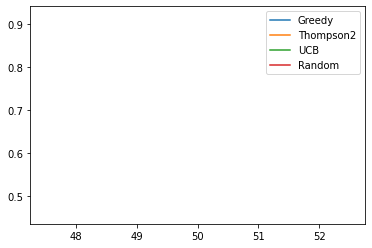

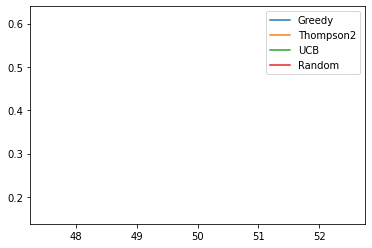

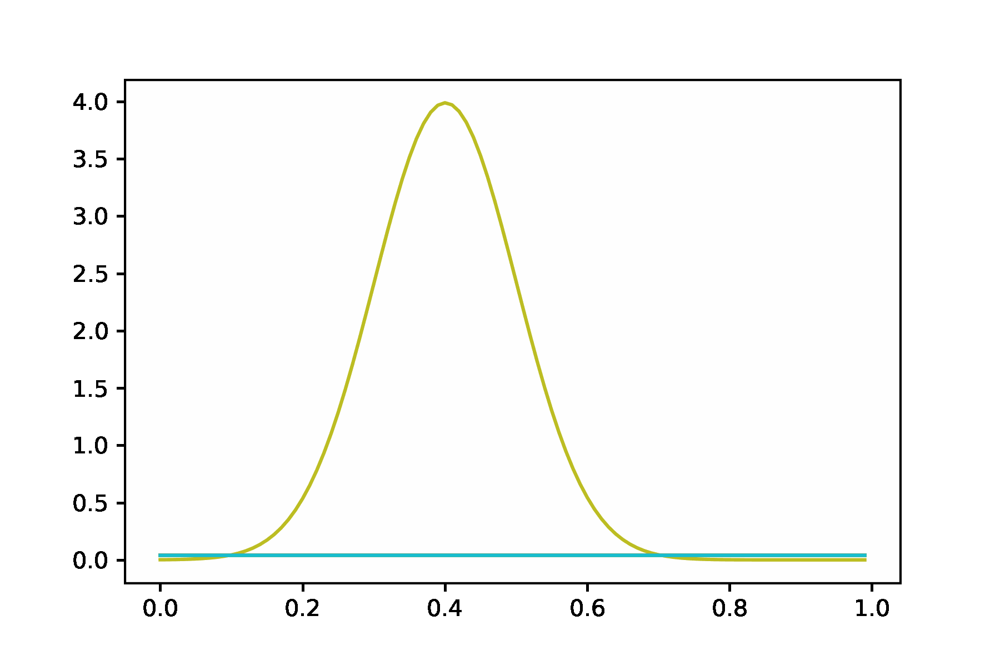

In [2]:
model_classes = [Greedy, Thompson2, UCB, Random]

money_list = [[] for _ in range(len(model_classes))]
regret_list = [[] for _ in range(len(model_classes))]
bandit_counts = range(50, 51, 5)
trials = 1
gif.options.matplotlib["dpi"] = 300
for n_bandits in bandit_counts:
    iterations = n_bandits*10
    iterations = 500
    bandits = [[Bandit(np.random.random(), 0.1) for i in range(n_bandits)] for _ in range(trials)]
    for n in range(len(model_classes)):
        money = 0
        regret = 0
        for t in range(trials):
            model = model_classes[n](bandits[t])
            mu, sig = [], []
            for i in range(iterations):
                b, r = model.pull()
                money += r
                if n == 1:
                    mu.append(deepcopy(model.mu))
                    sig.append(deepcopy(model.sig))
                regret += max(bandit.pull() for bandit in bandits[t]) - r
            @gif.frame
            def pp(frame):
                for i in range(50):
                    x = np.arange(0, 1, 0.01)
                    plt.plot(x, norm.pdf(x, mu[frame][i], np.sqrt(sig[frame][i])))
            def AnimationFunction(frame):
                fig = plt.Figure()
                for i in range(10):
                    x = np.arange(0, 1, 0.01)
                    # print(mu)
                    # print(mu[frame][i])
                    plt.plot(x, norm.pdf(x, mu[frame][i], np.sqrt(sig[frame][i])))
                fig.canvas.draw()  
                img = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
                img  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
                return img
            if n==1:
                frames = []
                for i in range(500):
                    frame = pp(i)
                    frames.append(frame)
                frames[0].save("my_awesome.gif", format="GIF", append_images=frames,
               save_all=True, duration=100, loop=0)
                # gif.save(frames, 'example.gif', duration=3.5, unit="s", between="startend")
                # imageio.mimsave('./powers.gif', frames, fps=10)
                # good practice to close the plt object.
                plt.close()
            print(1)
        money_list[n].append(money/trials/iterations)
        regret_list[n].append(regret/trials/iterations)
    # print(n_bandits)
for n in range(len(model_classes)):
    plt.plot(bandit_counts, money_list[n], label=model_classes[n].name)
plt.legend()
plt.show()
for n in range(len(model_classes)):
    plt.plot(bandit_counts, regret_list[n], label=model_classes[n].name)
plt.legend()
plt.show() 

Image(open('my_awesome.gif', 'rb').read())

In [3]:
print(regret_list)

[[0.35400510662996865], [0.16052581751215073], [0.4072869230620132], [0.6169560527074693]]
